Hypothesis testing

In [1]:
import numpy as np
from scipy import stats
data=np.random.randint(20,40,10)
H0="The avg weight of 10 years old child is 32 Kg"
H1="The avg weight of 10 year old child is more than 32 Kg"
t,p=stats.ttest_1samp(data,32)
print("test statistic:",t)
print("P_value:",p)

if p < 0.05:
  print("Reject the H0")
else:
  print("Fail to Reject the H0")

test statistic: -6.194224814505166
P_value: 0.0001599714280687144
Reject the H0


Model Selection

In [2]:
from numpy import mean, std
from sklearn.datasets import load_iris
from sklearn.model_selection import cross_val_score, RepeatedStratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from mlxtend.evaluate import paired_ttest_5x2cv

# Load a different dataset (e.g., Iris dataset)
iris = load_iris()
X, y = iris.data, iris.target

# Evaluate model 1: Logistic Regression
model1 = LogisticRegression(max_iter=1000)
cv1 = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
scores1 = cross_val_score(model1, X, y, scoring='accuracy', cv=cv1, n_jobs=-1)
print('LogisticRegression Mean Accuracy: %.3f (%.3f)' % (mean(scores1), std(scores1)))

# Evaluate model 2: Linear Discriminant Analysis
model2 = LinearDiscriminantAnalysis()
cv2 = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
scores2 = cross_val_score(model2, X, y, scoring='accuracy', cv=cv2, n_jobs=-1)
print('LinearDiscriminantAnalysis Mean Accuracy: %.3f (%.3f)' % (mean(scores2), std(scores2)))

# Check if the difference between algorithms is statistically significant using paired t-test
t, p = paired_ttest_5x2cv(estimator1=model1, estimator2=model2, X=X, y=y, scoring='accuracy', random_seed=1)

# Summarize the results of the t-test
print('P-value: %.3f, t-Statistic: %.3f' % (p, t))

# Interpret the result based on the p-value
if p <= 0.05:
    print('Difference between mean performance is probably real')
else:
    print('Algorithms probably have the same performance')

LogisticRegression Mean Accuracy: 0.964 (0.041)
LinearDiscriminantAnalysis Mean Accuracy: 0.980 (0.031)
P-value: 0.189, t-Statistic: -1.519
Algorithms probably have the same performance


Confusion matrix


Confusion Matrix:
[[40  3]
 [ 1 70]]
Accuracy: 0.965
Precision: 0.959
Recall: 0.986
F1 Score: 0.972


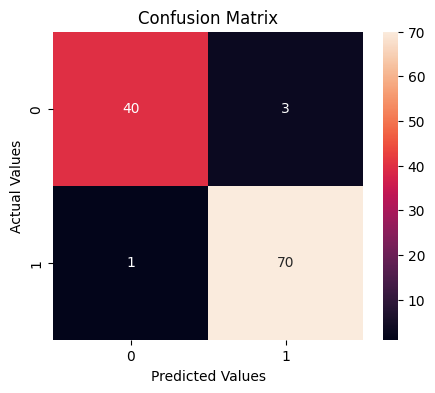

In [ ]:
from sklearn.datasets import load_breast_cancer
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import seaborn as sns

# Load Breast Cancer dataset
cancer = load_breast_cancer()
X = cancer.data
y = cancer.target

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train a classifier (Random Forest in this case)
clf = RandomForestClassifier(random_state=42)
clf.fit(X_train, y_train)

# Make predictions on the test set
y_pred = clf.predict(X_test)

# Calculate confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

# Print results
print(f"Confusion Matrix:\n{conf_matrix}")
print(f"Accuracy: {accuracy:.3f}")
print(f"Precision: {precision:.3f}")
print(f"Recall: {recall:.3f}")
print(f"F1 Score: {f1:.3f}")

# Visualize confusion matrix
plt.figure(figsize=(5,4))
sns.heatmap(conf_matrix, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

polynomial curve fitting


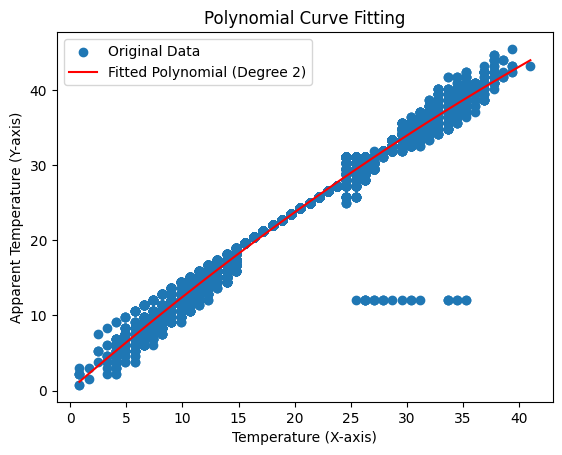

Quadratic Polynomial Equation:
           2
-0.005283 x + 1.285 x + 0.1373
Predicted output for x=6: 7.658324362988943


In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
data = pd.read_csv("/content/yulu_bike_sharing_dataset.csv")

# Extract X and Y columns
x_data = data['temp']
y_data = data['atemp']

# Fit a polynomial to the data
degree = 2  # You can change this to fit higher-degree polynomials
coefficients = np.polyfit(x_data, y_data, degree)
poly_fit = np.poly1d(coefficients)

# Generate points for the fitted polynomial curve
x_fit = np.linspace(min(x_data), max(x_data), 100)
y_fit = poly_fit(x_fit)

# Plot the original data and the fitted polynomial curve
fig, ax = plt.subplots()
ax.scatter(x_data, y_data, label='Original Data')
ax.plot(x_fit, y_fit, label=f'Fitted Polynomial (Degree {degree})', color='red')
ax.set_xlabel('Temperature (X-axis)')
ax.set_ylabel('Apparent Temperature (Y-axis)')
ax.set_title('Polynomial Curve Fitting')
ax.legend()
plt.show()

# Define the quadratic fit function
def quadratic_fit(x):
    return equation(x)

# Print the quadratic polynomial equation
equation = np.poly1d(coefficients)
print("Quadratic Polynomial Equation:")
print(equation)

# Set a new x value and get the corresponding y value
new_x_value = 6
predicted_y_value = quadratic_fit(new_x_value)
print(f"Predicted output for x={new_x_value}: {predicted_y_value}")

Emotion Detection

  Using cached fer-22.5.1-py3-none-any.whl (1.5 MB)
  Using cached facenet_pytorch-2.5.3-py3-none-any.whl (1.9 MB)
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)


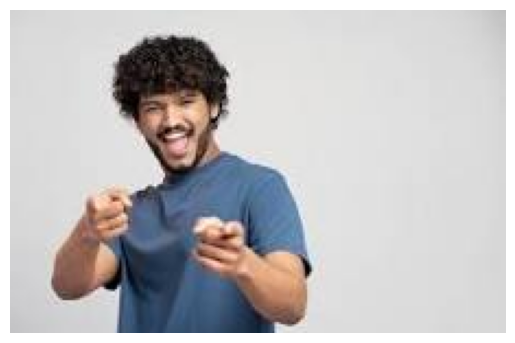

Dominant Emotion: happy


In [6]:
!pip install fer
from fer import FER
import cv2
import matplotlib.pyplot as plt

# Initialize emotion detector
emotion_detector = FER(mtcnn=True)

# Load the image
test_img_low_quality = cv2.imread("/content/download.jpeg")

# Detect emotions
analysis = emotion_detector.detect_emotions(test_img_low_quality)

# Display the image
plt.imshow(cv2.cvtColor(test_img_low_quality, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# Extract dominant emotion
dominant_emotion = max(analysis[0]['emotions'], key=analysis[0]['emotions'].get)

# Display the dominant emotion
print("Dominant Emotion:", dominant_emotion)

Vehicle Audio Identification

In [7]:
import librosa
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

def extract_features(file_path):
    audio_data, sample_rate = librosa.load(file_path)
    mfccs = librosa.feature.mfcc(y=audio_data, sr=sample_rate, n_mfcc=13)
    return np.mean(mfccs.T, axis=0)

audio_files = ["/content/BIKERS_100___Best_of_Superbikes_Sounds,_Wheelie_and_Burnout_Ultimate_Compilation_003 (1).wav",
               "/content/Best_Of_American_Trucks___Sound_001.wav",
               "/content/Bus_Driving_Sound_1_HOUR_095.wav",
               "/content/Car_Passing_Sound_Effects_2.wav"]

labels = ["bike", "Truck", "bus", "car"]

X = np.array([extract_features(file) for file in audio_files])
y = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

new_sample = "/content/Car_Passing_Sound_Effects_2.wav"
new_features = extract_features(new_sample)
predicted_label = clf.predict([new_features])[0]

print("Predicted label for new_sample is:", predicted_label)

Predicted label for new_sample is: car


Speech emotion recognition


In [8]:
#Sentiment analysis using Audio
!pip install SpeechRecognition
!pip install textblob
import speech_recognition as sr
from textblob import TextBlob

def analyze_sentiment(audio_file):
    # Initialize the speech recognition recognizer
    recognizer = sr.Recognizer()

    # Load the audio file
    with sr.AudioFile(audio_file) as source:
        audio_data = recognizer.record(source)

    # Recognize speech using Google Web Speech API
    try:
        text = recognizer.recognize_google(audio_data)
        print("Transcribed Text:", text)

        # Perform sentiment analysis on the transcribed text
        blob = TextBlob(text)
        sentiment = blob.sentiment

        # Print sentiment analysis results
        print("Sentiment Polarity:", sentiment.polarity)
        print("Sentiment Subjectivity:", sentiment.subjectivity)

        # Return sentiment polarity
        return sentiment.polarity

    except sr.UnknownValueError:
        print("Google Web Speech API could not understand audio")
        return None
    except sr.RequestError as e:
        print("Could not request results from Google Web Speech API; {0}".format(e))
        return None

# Example usage
audio_file = "/content/positive_words.wav"
sentiment_score = analyze_sentiment(audio_file)
if sentiment_score is not None:
    if sentiment_score > 0:
        print("Sentiment: Positive")
    elif sentiment_score < 0:
        print("Sentiment: Negative")
    else:
        print("Sentiment: Neutral")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 32.8/32.8 MB 18.4 MB/s eta 0:00:00
Transcribed Text: hey I'm doing very well what about you
Sentiment Polarity: 0.2
Sentiment Subjectivity: 0.3
Sentiment: Positive


Synthetic Video Detection

In [10]:
# Synthetic video dteection
import cv2

def detect_ai_generated(video_path):
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
    cap = cv2.VideoCapture(video_path)

    if not cap.isOpened():
        print("Error: Unable to open video file.")
        return None

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        if frame is None:
            continue

        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

        if len(faces) > 0:  # Check if any faces are detected in the frame
            cap.release()
            return False  # Faces detected, video is likely not AI-generated

    cap.release()

    # If no faces were detected in any frame, the video is likely AI-generated
    return True

# Example usage
video_path = ""  # Update with correct video path
is_ai_generated = detect_ai_generated("/content/WhatsApp Video 2024-04-11 at 1.00.40 AM.mp4")

if is_ai_generated is not None:
    if is_ai_generated:
        print("The video is Synthetic")
    else:
        print("The video is Not Synthetic")

The video is Not Synthetic


Image Segmentation

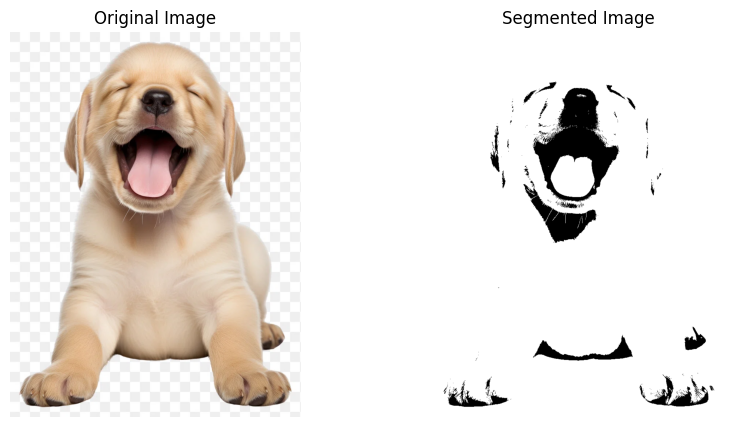

In [11]:
  # Image segmentation
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Read the image
image = cv2.imread("/content/dog.webp")

# Convert image to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply thresholding
ret, segmented_image = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)

# Display the original and segmented image
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(segmented_image, cmap='gray')
plt.title('Segmented Image')
plt.axis('off')

plt.show()

person detection in video

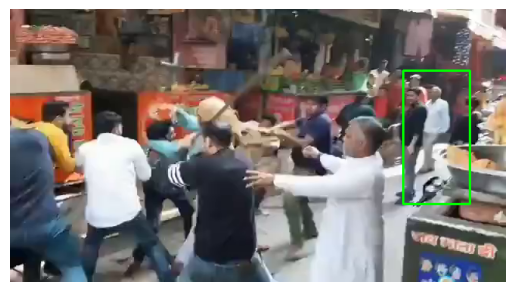

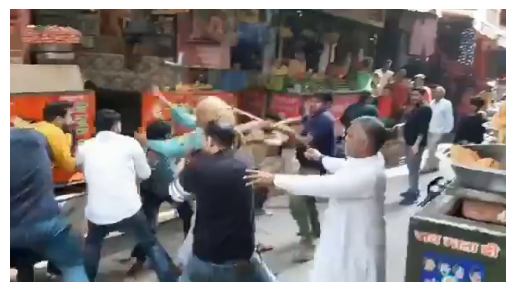

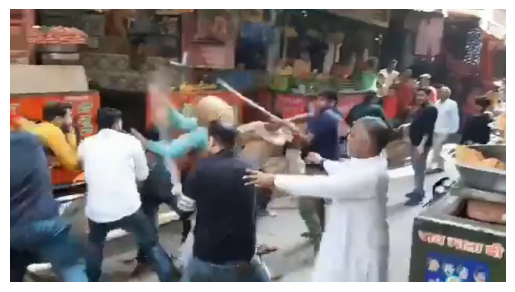

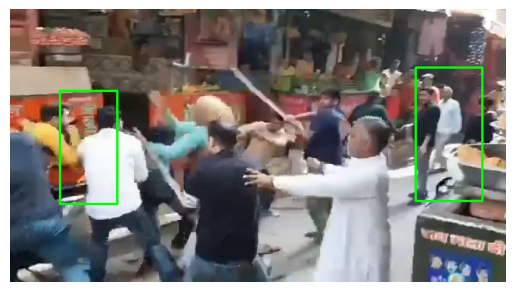

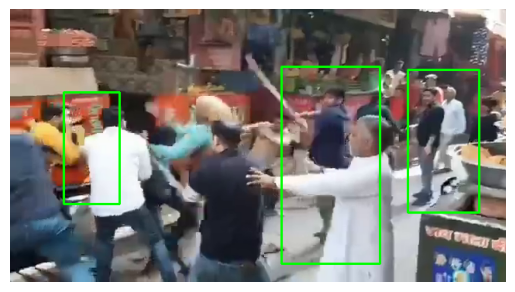

...

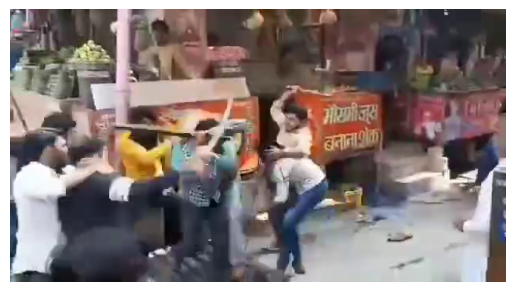

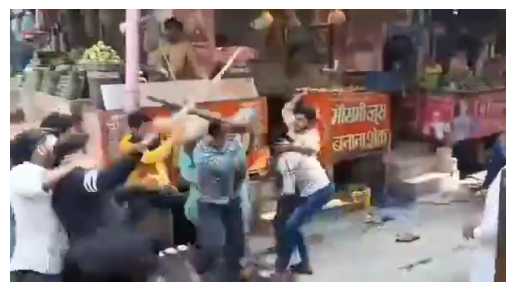

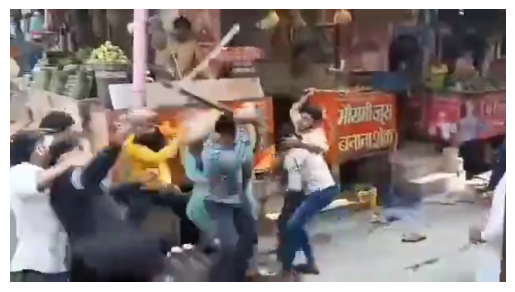

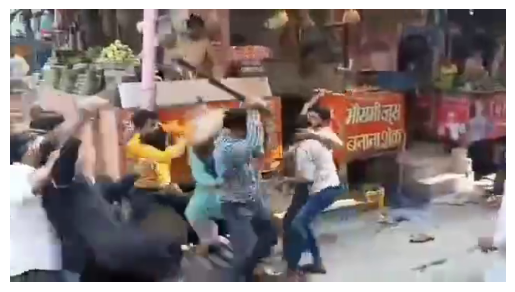

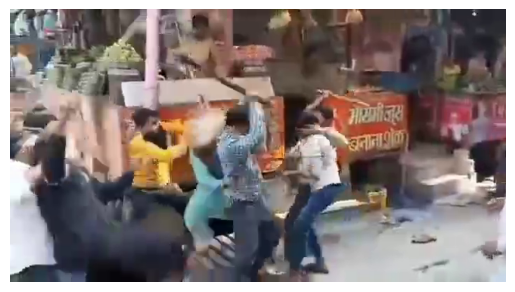

Anomaly detected.


In [12]:
#Person detection in video using anamoly
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Initialize the HOG descriptor/person detector
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())

# Open video file
video_path = "input_video.mp4"
cap = cv2.VideoCapture("/content/WhatsApp Video 2024-04-11 at 1.00.40 AM.mp4")


# Get the frame width and height
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define the codec and create VideoWriter object for output video
out = cv2.VideoWriter('output.avi', cv2.VideoWriter_fourcc(*'MJPG'), 15., (frame_width, frame_height))

# Variables for anomaly detection
anomaly_threshold = 0.1  # Threshold for anomaly detection (adjust as needed)
anomaly_detected = False

while True:
    # Capture frame-by-frame
    ret, frame = cap.read()

    if not ret:
        break

    # Convert frame to grayscale
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Detect people in the image
    # Returns the bounding boxes for the detected objects
    boxes, weights = hog.detectMultiScale(frame, winStride=(8, 8))

    # Convert bounding boxes to numpy array
    boxes = np.array([[x, y, x + w, y + h] for (x, y, w, h) in boxes])

    # Draw bounding boxes
    for (xA, yA, xB, yB) in boxes:
        cv2.rectangle(frame, (xA, yA), (xB, yB), (0, 255, 0), 2)

    # Anomaly detection
    num_persons = len(boxes)
    if num_persons == 0:
        anomaly_detected = True

    # Write the frame into the output video
    out.write(frame)

    # Display the resulting frame using matplotlib
    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    # Check for 'q' key press to exit
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release VideoCapture and VideoWriter objects
cap.release()
out.release()

# Close all OpenCV windows
cv2.destroyAllWindows()

# Print anomaly detection result
if anomaly_detected:
    print("Anomaly detected.")
else:
    print("No anomalies detected.")


Intrusion detection

In [14]:
# Intrusion Detection in Log
import re

# Function to read log file and detect anomalies
def detect_intrusions(log_file):
    # Read the log file
    with open(log_file, 'r') as file:
        log_data = file.readlines()

    # Define patterns for normal log entries
    normal_patterns = [
        r'\d+\.\d+\.\d+\.\d+ - \w+ \[\d+/\w+/\d+:\d+:\d+:\d+ \+\d+\] "[A-Z]+ /[\w\/\.]+" \d+ \d+ "[\w\/\.\-]*" "[\w\/\.\-]*"',
        # Add more patterns as needed for your log format
    ]

    # Define patterns for detecting anomalies
    anomaly_patterns = [
        r'.*WARNING:INTRUSION_ATTEMPT:.*',
        r'.*ERROR:.*',
        # Add more specific anomaly patterns as needed
    ]

    # Iterate over log entries
    anomalies_detected = False
    for log_entry in log_data:
        is_normal = False
        for pattern in normal_patterns:
            if re.match(pattern, log_entry):
                is_normal = True
                break
        if not is_normal:
            # Anomaly detected, check against anomaly patterns
            for anomaly_pattern in anomaly_patterns:
                if re.match(anomaly_pattern, log_entry):
                    print(f"Anomaly detected: {log_entry.strip()}")
                    anomalies_detected = True
                    break  # Once an anomaly is detected, no need to check further patterns

    if not anomalies_detected:
        print("No anomalies detected")

# Example usage
detect_intrusions("/content/logfile.txt")

No anomalies detected
